# An Interactive Exploration of Prevalence and Transmission Ratio

In [2]:
from datetime import date, datetime, timedelta


import pandas as pd
import numpy as np

from loguru import logger
import pycountry

from matplotlib.pylab import plt
import matplotlib


import seaborn as sns

import plotly.io as pio
import plotly_express as px

import chart_studio.plotly as py
import chart_studio

from IPython.display import clear_output


import sys
import os
sys.path.insert(0, os.path.abspath('../../src/'))
import pipeline


%matplotlib inline

!pwd

/home/barry/projects/covid_projects/the_shape_of_covid/notebooks


# Load OWID Base Dataset 

In [4]:
df = pd.read_pickle('../../generating_covid_datasets/data/base_owid.pkl')
df.shape, df['country'].nunique(), df.date.max()

((42838, 10), 208, Timestamp('2020-09-14 00:00:00'))

# Main Data Pipeline

In [5]:
recency_period = '14d'
def compute_recent_deaths(df, deaths_col='new_deaths_per_100k_rolling', recency_period=recency_period):
    
    recent_deaths_col = 'recent_deaths_{}'.format(recency_period)
    
    # The sum of the new deaths during the infectous period.
    recent_deaths = df.groupby('country')\
        .apply(lambda g: g.set_index('date')[[deaths_col]].rolling(recency_period).sum().clip(lower=.01))\
        .rename(columns={deaths_col: recent_deaths_col})
    
    return df.set_index(['country', 'date']).join(recent_deaths).reset_index()

df = df.pipe(pipeline.compute_per_100k)\
    .pipe(pipeline.compute_totals_per_100k)\
    .pipe(pipeline.compute_rolling)\
    .pipe(pipeline.compute_prevalence)\
    .pipe(compute_recent_deaths)\
    .pipe(pipeline.compute_transmission_ratio)\

df.tail()

,country,date,country_code,country_id,continent,region,new_cases,new_deaths,new_tests_smoothed,population,...,total_tests_smoothed_per_100k,new_cases_per_100k_rolling,new_deaths_per_100k_rolling,new_tests_smoothed_per_100k_rolling,total_cases_per_100k_rolling,total_deaths_per_100k_rolling,total_tests_smoothed_per_100k_rolling,new_cases_per_100k_rolling_prevalence_14d,recent_deaths_14d,new_cases_per_100k_rolling_transmission_ratio_7d
42833,Zimbabwe,2020-09-10,ZWE,ZW,Africa,east_africa,41.0,4.0,649.0,14862927.0,...,644.637493,0.760281,0.015379,5.017277,47.523806,1.417717,630.817873,7.251023,0.349864,0.094572
42834,Zimbabwe,2020-09-11,ZWE,ZW,Africa,east_africa,24.0,0.0,NaN,14862927.0,...,NaN,0.744902,0.015379,4.809506,48.268708,1.433096,633.324109,7.470169,0.328718,0.096936
42835,Zimbabwe,2020-09-12,ZWE,ZW,Africa,east_africa,26.0,2.0,NaN,14862927.0,...,NaN,0.617067,0.017301,4.667990,48.885776,1.450397,635.729423,7.536489,0.304689,0.083366
42836,Zimbabwe,2020-09-13,ZWE,ZW,Africa,east_africa,29.0,0.0,NaN,14862927.0,...,NaN,0.644941,0.017301,4.521317,49.530717,1.467698,638.023722,7.688353,0.280660,0.090492
42837,Zimbabwe,2020-09-14,ZWE,ZW,Africa,east_africa,18.0,0.0,NaN,14862927.0,...,NaN,0.527679,0.016340,4.411424,50.058396,1.484038,640.230555,7.752751,0.257592,0.075092


# Prevalence, Transmission Ratio & Recent Deaths
The relationship between prevalence and tramsission ratio is an interesting one to ponder and to get a better feel for this the interactive chart below plots different countries based on their prevalence and transmission ratio values over time. The size of the country marker is proprotional to the sum total of the last two weeks of deaths (per 100,000 of poulation) in that country.

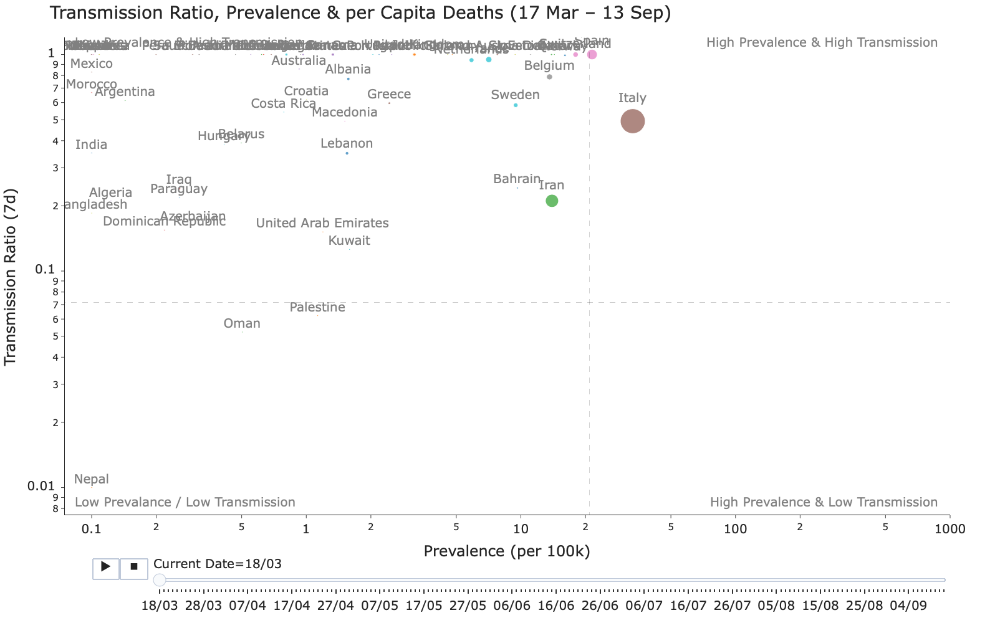

In [6]:
from_date = datetime(2020, 3, 17)
to_date = df['date'].max()-timedelta(days=1)

prevalence_col = 'new_cases_per_100k_rolling_prevalence_14d'
transmission_ratio_col = 'new_cases_per_100k_rolling_transmission_ratio_7d'
deaths_col = 'recent_deaths_14d'

between_dates = (df['date']>from_date) & (df['date']<to_date)

countries = [
    'Austria', 'Belgium', 'Bulgaria', 'Croatia',
    'Czech Republic', 'Denmark', 'Finland', 'France',
    'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy',
    'Luxembourg', 'Netherlands', 'Poland',
    'Portugal', 'Romania', 'Spain', 'Sweden', 
    'United Kingdom', 'Iceland', 'Norway', 'Switzerland', 'Canada', 
    
    'Israel', 'Japan', 'South Korea', 'Australia', 
    'South Africa',
    'United States', 'Brazil', 'Peru', 'Chile', 'Mexico'
    
#     'Ireland', 'Italy', 'United States', 'Brazil'
]

# countries =['United States']


# The Long-List used in the final analysis
min_cases_per_100k = 100
total_cases_per_100k = df.groupby('country').last()['total_cases_per_100k_rolling']
countries_with_min_cases = set(total_cases_per_100k[total_cases_per_100k>min_cases_per_100k].index)

min_deaths_per_100k = min_cases_per_100k*.01
total_deaths_per_100k = df.groupby('country').last()['total_deaths_per_100k_rolling']
countries_with_min_deaths = set(total_deaths_per_100k[total_deaths_per_100k>min_deaths_per_100k].index)

min_pop = 1000000
populations = df.groupby('country').last()['population']
countries_with_min_pop = set(populations[populations>min_pop].index)

countries = countries_with_min_cases.intersection(countries_with_min_deaths).intersection(countries_with_min_pop)


use_countries = df['country'].isin(countries)



# use_countries = (df['population']>3000000) & df['region'].isin(['eu', 'non-eu', 'northern_america'])

use_df = df[use_countries & between_dates][
    ['continent', 'region', 'country', 'date', prevalence_col, transmission_ratio_col, deaths_col]].dropna()

use_df["Current Date"] = use_df["date"].map(lambda date: date.strftime('%d/%m'))

fig = px.scatter(
    use_df,
    x=use_df[prevalence_col].clip(lower=.1),
    y=use_df[transmission_ratio_col].clip(lower=.01, upper=1), 
    
    animation_frame='Current Date', animation_group="country",
    size=deaths_col, 
    color="country", hover_name="country", 
    log_x = True, log_y=True,  
    size_max=100, 
    range_x=[.075, 1000], 
    range_y=[.0075, 1.2],
    width=16*1000/9, height=1000,
    template='simple_white', 
    text=use_df['country'],
)

fig.update_traces(hovertemplate=None, hoverinfo='skip')
fig.update_traces(textposition='top center', textfont=dict(size=20, color="grey"))

# Add the quadrant lines
fig.update_layout(shapes=[         
    dict(
        type="line",
        y0=1/14,
        y1=1/14,
        x0=0,
        x1=1000,
        line=dict(color="black", width=1, dash="dash")),
    
    # The vertical line at the median prevalence
    dict(
        type="line",
        y0=0,
        y1=1.5,
        x0=use_df[prevalence_col].median(),
        x1=use_df[prevalence_col].median(),
        line=dict(color="black", width=1, dash="dash"),
    )])

fig.update_layout(
    title='Transmission Ratio, Prevalence & per Capita Deaths ({} – {})'.format(from_date.strftime('%d %b'), to_date.strftime('%d %b')),
    xaxis_title="Prevalence (per 100k)",
    yaxis_title="Transmission Ratio (7d)",
    font=dict(size=20)
)


# Add the quadrant labels
fig.add_annotation(xref='paper', yref='paper', x=.01, y=.01, text="Low Prevalance / Low Transmission", showarrow=False, font=dict(color="grey", size=20))
fig.add_annotation(xref='paper', yref='paper', x=.01, y=1.01, text="Low Prevalence & High Transmission", showarrow=False, font=dict(color="grey", size=20))

fig.add_annotation(xref='paper', yref='paper', x=.99, y=.01, text="High Prevalence & Low Transmission", showarrow=False, font=dict(color="grey", size=20))
fig.add_annotation(xref='paper', yref='paper', x=.99, y=1.01, text="High Prevalence & High Transmission", showarrow=False, font=dict(color="grey", size=20))

fig.update_layout(showlegend=False)

Notice how many countries follow a similar trajectory over time. During the early stages of the pandemic most are associated with high transmission rates, but still enjoy low prevalence. By the middle of April these transmission rates have shifted most countries from a low prevalance position to a high prevalence one, and in general, this has been accompanied by a significant increase in deaths; the marker sizes, indicating recent deaths per capita, for most high prevalence countries, grow steadily during April but peak by the end of that month. As we enter May, transmission rates are being brought under control, to a lesser or greater extent, mostly due to lockdowns, and for many countries prevalance begins to fall. In June, these countries transition from a high prevalence state to a low prevalence one, but in July the transmission ratio starts to increase again, foretlling a July prevalence increase. 

The end of July/start of August marks the beginning of a new *second cycle* in this visualisation, which can be usefully interpreted as the so-called *second wave*. We will come back to this later but for now, notice that not every country follows this route. For example, the US, Brazil, Peru, and Chile do not manage to exert the same level of control over their outbreaks and, as a result, they never recover to a low prevalence state, and never complete a full cycle. Instead, in the visualisation they are seen to bob around the high prevalence portion of the graph, only temporarily, if at all, reducing their transmission ratio, and never for long enough to materially affect prevalence. In this sense countries like the US, Peru, Brazil, and Chile remain in an extended first wave of their outbreak. 

Importantly, the second-cycle countries can be distinguished from first-cycle countries, because the former present with much lower recent death rates. For example, by the end of August, almost all second-cyle countries have recent death rates that are a small fraction of the corresponding death rates in first-cyle countries. Romania and Bulgaria are notable second cycle exceptions: both have higher prevalance now than they did in their first cycle, and both are experiencing much higher death rates now than in their first cycle. 

In comparison, the recent death rates in the US, Peru, Brazil, and Chile stand out as particularly high, relative to other countries; while deaths in the US are lower than its April highs they are nonetheless far higher than second-cycle countries. Indeed, in the above visualisation the first-cycle countries have an average recent death count of more than 6 deaths per 100k of population, compared to just 0.6 for second cycle countries, a >10x difference.

As an aside, I find it very interesting how this visualisation acts as a type of exploratory tool with which to better understand how countries have responded to, and been affected by, the pandemic. I think it would have been difficult to make the observations above by looking at a static graph, or even a sequence of snapshots at different posints in time, while the ability to scrub back and forth through time helps to identify different patterns in the trajectories of countries which, I believe, reveal meaningful differences in how these countries have responded to the pandemic. In particular, these observations lead me to conclude that it is worthwhile to compare the traces of different countries over time. So let's take a look at that next.

In [ ]:
# # Try to upload to plotly
# username = 'barrysmyth' # your username
# api_key = 'REMOVED' # your api key - go to profile > settings > regenerate key
# chart_studio.tools.set_credentials_file(username=username, api_key=api_key)

# py.plot(fig, filename = 'transmission_rate_vs_prevalence_reduced', auto_open=True)

In [ ]:
pio.write_html(fig, file='index.html', auto_open=True)

In [ ]:
second_cycle = [
    'Austria', 'Belgium', 'Bulgaria', 'Croatia',
    'Czech Republic', 'Denmark', 'Finland', 'France',
    'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy',
    'Luxembourg', 'Netherlands', 'Poland',
    'Spain', 
    'United Kingdom', 'Iceland', 'Norway', 'Switzerland', 'Canada', 
    'Israel', 'Japan', 'South Korea', 'Australia', 
    'Romania', 'South Africa', 'Portugal', 'Sweden'
]

first_cycle = [
    'United States', 'Peru', 'Brazil', 'Chile', 'Mexico', 
    'South Africa',
]

In [ ]:
df.groupby('country').last()['recent_deaths_14d'].loc[first_cycle].mean()

In [ ]:
df.groupby('country').last()['recent_deaths_14d'].loc[second_cycle].mean()

In [ ]:
(df.groupby('country').apply(
    lambda g: g.set_index('date').loc[datetime(2020, 8, 1):]['new_deaths_per_100k'].rolling('30d').sum().mean()
).loc[countries]/df.groupby('country').apply(
    lambda g: g.set_index('date').loc[:datetime(2020, 8, 1)]['new_deaths_per_100k'].rolling('30d').sum().mean()
).loc[countries]).sort_values()